## **Reduce maintenance cost through predictive techniques**

### Background

Company (3D Technologies) has a fleet of devices transmitting daily aggregated telemetry attributes.
Predictive maintenance techniques are designed to help determine the condition of in-service equipment in order to predict when maintenance should be performed. This approach promises cost savings over routine or time-based preventive maintenance, because tasks are performed only when warranted.

### Goal

You are tasked with building a predictive model using machine learning to predict the probability of a device failure. When building this model, be sure to minimize false positives and false negatives. The column you are trying to predict is called failure with binary value 0 for non-failure and 1 for failure.

### **Architecture Design Principles**

I'll set the KPI(Key Performance Index) for my task first. I'll evaluate my task using these measurements when I finished my task.

Reference: AWS Well Architected Framework - https://d1.awsstatic.com/whitepapers/architecture/AWS_Well-Architected_Framework.pdf

#### **1. Operational Excellence**

The ability to run and monitor systems to deliver business value and to continually improve supporting processes and procedures.

#### **2. Security**

The ability to protect information, systems, and assets while delivering business value through risk assessments and mitigation strategies.

#### **3. Reliability**

The ability of a system to recover from infrastructure or service disruptions, dynamically acquire computing resources to meet demand, and mitigate disruptions such as misconfigurations or transient network issues.

#### **4. Performance Efficiency**

The ability to use computing resources efficiently to meet system requirements, and to maintain that efficiency as demand changes and technologies evolve.

#### **5. Cost Optimization**

The ability to run systems to deliver business value at the lowest price point.

## Step1. EDA(Exploratory Data Analysis) & Data Preprocessing

Deep dive into the dataset.

### 1-1. Download the csv file

In [0]:
import pandas as pd
import numpy as np
import seaborn as sns
import tensorflow as tf


In [0]:
filepath = tf.keras.utils.get_file(
    origin='http://aws-proserve-data-science.s3.amazonaws.com/device_failure.csv',
    fname='device_failure.csv')

In [0]:
df = pd.read_csv(filepath, encoding="ISO-8859-1")

### 1-2. Print head of the file

In [108]:
df.head()

,date,device,failure,attribute1,attribute2,attribute3,attribute4,attribute5,attribute6,attribute7,attribute8,attribute9
0,2015-01-01,S1F01085,0,215630672,56,0,52,6,407438,0,0,7
1,2015-01-01,S1F0166B,0,61370680,0,3,0,6,403174,0,0,0
2,2015-01-01,S1F01E6Y,0,173295968,0,0,0,12,237394,0,0,0
3,2015-01-01,S1F01JE0,0,79694024,0,0,0,6,410186,0,0,0
4,2015-01-01,S1F01R2B,0,135970480,0,0,0,15,313173,0,0,3


### 1-3. Check numerical data statistics - mean, stdev, min, max

In [109]:
df.describe()

,failure,attribute1,attribute2,attribute3,attribute4,attribute5,attribute6,attribute7,attribute8,attribute9
count,124494.000000,1.244940e+05,124494.000000,124494.000000,124494.000000,124494.000000,124494.000000,124494.000000,124494.000000,124494.000000
mean,0.000851,1.223881e+08,159.484762,9.940455,1.741120,14.222669,260172.657726,0.292528,0.292528,12.451524
std,0.029167,7.045933e+07,2179.657730,185.747321,22.908507,15.943028,99151.078547,7.436924,7.436924,191.425623
min,0.000000,0.000000e+00,0.000000,0.000000,0.000000,1.000000,8.000000,0.000000,0.000000,0.000000
25%,0.000000,6.128476e+07,0.000000,0.000000,0.000000,8.000000,221452.000000,0.000000,0.000000,0.000000
50%,0.000000,1.227974e+08,0.000000,0.000000,0.000000,10.000000,249799.500000,0.000000,0.000000,0.000000
75%,0.000000,1.833096e+08,0.000000,0.000000,0.000000,12.000000,310266.000000,0.000000,0.000000,0.000000
max,1.000000,2.441405e+08,64968.000000,24929.000000,1666.000000,98.000000,689161.000000,832.000000,832.000000,18701.000000


### 1-4. Check null data to validate the data quality

---



In [110]:
df.isnull().sum()

date          0
device        0
failure       0
attribute1    0
attribute2    0
attribute3    0
attribute4    0
attribute5    0
attribute6    0
attribute7    0
attribute8    0
attribute9    0
dtype: int64

There is no Nan or Null data. Okay to go.

### 1-5. Plot the covariance pair plot to check the correlation between features

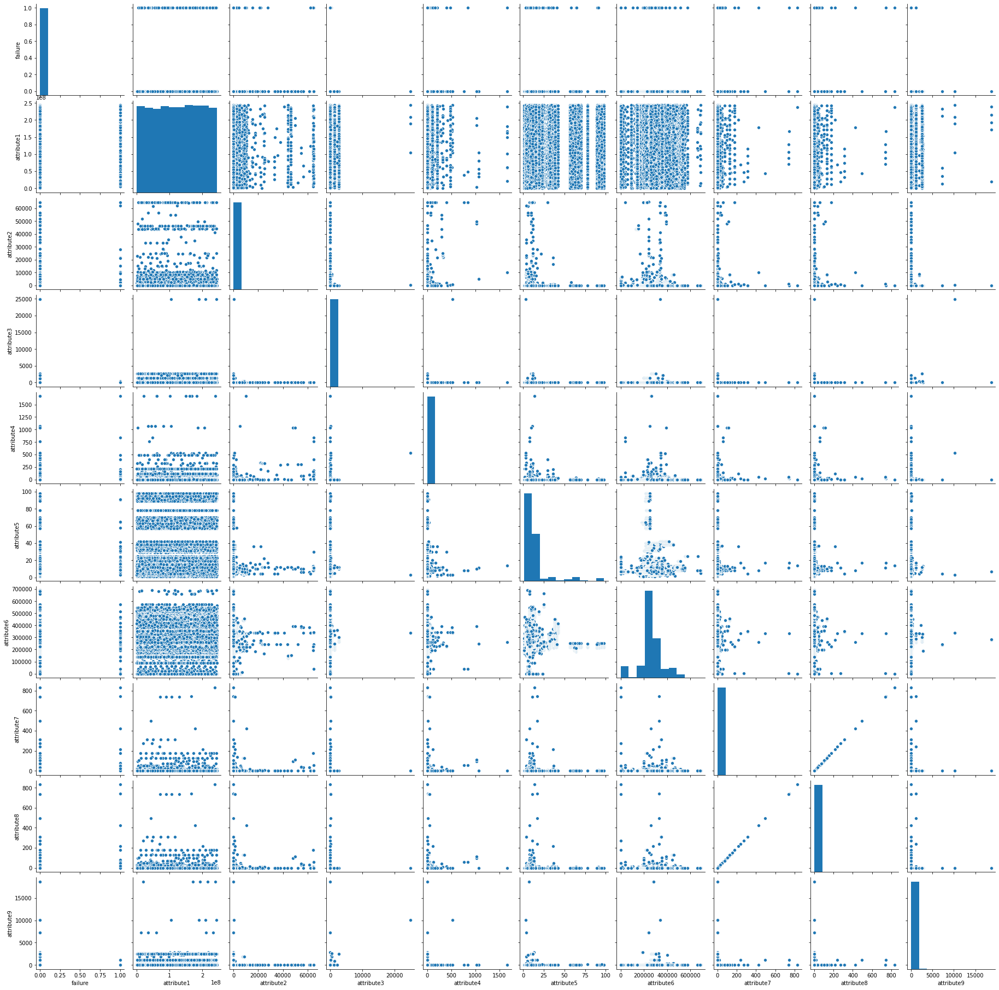

In [111]:
sns.pairplot(df)

### **Decision 1.**
On this pairplot, I found that attribute7 and attribute8 are identical. Redundant feature is not helpful for the model training. 

So, I'm going to **remove attribute8.**

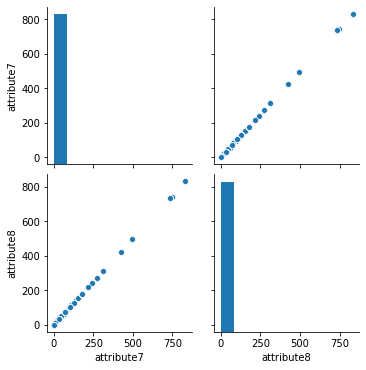

In [112]:
sns.pairplot(df[["attribute7","attribute8"]])

In [0]:
df2 = df.drop(['failure', 'device', 'date'], axis=1)
normalized_df=(df2-df2.mean())/df2.std()

In [114]:
normalized_df

,attribute1,attribute2,attribute3,attribute4,attribute5,attribute6,attribute7,attribute8,attribute9
0,1.323353,-0.047478,-0.053516,2.193896,-0.515753,1.485262,-0.039335,-0.039335,-0.028479
1,-0.865995,-0.073170,-0.037365,-0.076003,-0.515753,1.442257,-0.039335,-0.039335,-0.065046
2,0.722514,-0.073170,-0.053516,-0.076003,-0.139413,-0.229737,-0.039335,-0.039335,-0.065046
3,-0.605939,-0.073170,-0.053516,-0.076003,-0.515753,1.512977,-0.039335,-0.039335,-0.065046
4,0.192769,-0.073170,-0.053516,-0.076003,0.048757,0.534541,-0.039335,-0.039335,-0.049374
...,...,...,...,...,...,...,...,...,...
124489,-1.477134,-0.073170,-0.053516,-0.076003,-0.264860,0.943332,1.036379,1.036379,-0.065046
124490,0.712022,-0.029126,0.522535,0.098604,-0.202137,0.732411,-0.039335,-0.039335,0.002865
124491,-1.466931,2.143692,-0.053516,-0.076003,-0.202137,0.910099,-0.039335,-0.039335,-0.065046
124492,1.484052,-0.073170,-0.053516,-0.076003,-0.139413,0.996533,-0.039335,-0.039335,-0.065046


### 1-6. Check outliers

In [115]:
import matplotlib.pyplot as plt
import plotly.graph_objects as go

fig = go.Figure()

# Add traces
fig.add_trace(go.Scatter(x=np.linspace(0, normalized_df.size), y=normalized_df['attribute1'],
                    mode='lines',
                    name='attribute1'))
fig.add_trace(go.Scatter(x=np.linspace(0, normalized_df.size), y=normalized_df['attribute2'],
                    mode='lines',
                    name='attribute2'))
fig.add_trace(go.Scatter(x=np.linspace(0, normalized_df.size), y=normalized_df['attribute3'],
                    mode='lines',
                    name='attribute3'))
fig.add_trace(go.Scatter(x=np.linspace(0, normalized_df.size), y=normalized_df['attribute4'],
                    mode='lines',
                    name='attribute4'))
fig.add_trace(go.Scatter(x=np.linspace(0, normalized_df.size), y=normalized_df['attribute5'],
                    mode='lines',
                    name='attribute5'))
fig.add_trace(go.Scatter(x=np.linspace(0, normalized_df.size), y=normalized_df['attribute6'],
                    mode='lines',
                    name='attribute6'))
fig.add_trace(go.Scatter(x=np.linspace(0, normalized_df.size), y=normalized_df['attribute7'],
                    mode='lines',
                    name='attribute7'))
fig.add_trace(go.Scatter(x=np.linspace(0, normalized_df.size), y=normalized_df['attribute9'],
                    mode='lines',
                    name='attribute9'))

fig.show()

### **Decision 2. Truncate the outliers**

I found outliers in atrribute 4, 3, 9. Outliers causes gradient explosion and overfitting problem. Therefore, I'm going to truncate the outliers from the original dataset and standardize the dataset again.

In [116]:
df['attribute9'].describe()

count    124494.000000
mean         12.451524
std         191.425623
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max       18701.000000
Name: attribute9, dtype: float64

You can see that max value is way higher than the mean and median of attribute9. 

I'm going to truncate the outliers outside median +- stdev. I'm using median because median is less likely to afftected by outliers.

$$\eta = median, \sigma = stdev \\ [\eta - \sigma, \eta + \sigma]$$

In [0]:
attr9_lower = df['attribute9'].median() - df['attribute9'].std()
attr9_upper = df['attribute9'].median() + df['attribute9'].std()

In [118]:
attr9_lower, attr9_upper

(-191.4256229854582, 191.4256229854582)

In [119]:
df[(attr9_lower < df['attribute9']) & (df['attribute9'] < attr9_upper)]

,date,device,failure,attribute1,attribute2,attribute3,attribute4,attribute5,attribute6,attribute7,attribute8,attribute9
0,2015-01-01,S1F01085,0,215630672,56,0,52,6,407438,0,0,7
1,2015-01-01,S1F0166B,0,61370680,0,3,0,6,403174,0,0,0
2,2015-01-01,S1F01E6Y,0,173295968,0,0,0,12,237394,0,0,0
3,2015-01-01,S1F01JE0,0,79694024,0,0,0,6,410186,0,0,0
4,2015-01-01,S1F01R2B,0,135970480,0,0,0,15,313173,0,0,3
...,...,...,...,...,...,...,...,...,...,...,...,...
124489,2015-11-02,Z1F0MA1S,0,18310224,0,0,0,10,353705,8,8,0
124490,2015-11-02,Z1F0Q8RT,0,172556680,96,107,4,11,332792,0,0,13
124491,2015-11-02,Z1F0QK05,0,19029120,4832,0,0,11,350410,0,0,0
124492,2015-11-02,Z1F0QL3N,0,226953408,0,0,0,12,358980,0,0,0


In [0]:
attr3_lower = df['attribute3'].median() - df['attribute3'].std()
attr3_upper = df['attribute3'].median() + df['attribute3'].std()
attr4_lower = df['attribute4'].median() - df['attribute4'].std()
attr4_upper = df['attribute4'].median() + df['attribute4'].std()

In [0]:
df_truncated = df[(attr3_lower < df['attribute3']) & (df['attribute3'] < attr3_upper) & (attr4_lower < df['attribute4']) & (df['attribute4'] < attr4_upper) & (attr9_lower < df['attribute9']) & (df['attribute9'] < attr9_upper)]

### 1-7. Normalize the dataset again after removing outliers.

In [122]:
from sklearn.preprocessing import StandardScaler
pd.options.mode.chained_assignment = None

scaler = StandardScaler()
df2 = df_truncated
columns = ['attribute1', 'attribute2', 'attribute3', 'attribute4', 'attribute5',
     'attribute6', 'attribute7', 'attribute8', 'attribute9']
df2.loc[:, columns] = scaler.fit_transform(df2.loc[:,columns])
df2

,date,device,failure,attribute1,attribute2,attribute3,attribute4,attribute5,attribute6,attribute7,attribute8,attribute9
1,2015-01-01,S1F0166B,0,-0.865604,-0.070709,0.262350,-0.219277,-0.513329,1.439477,-0.040481,-0.040481,-0.175571
2,2015-01-01,S1F01E6Y,0,0.722425,-0.070709,-0.119606,-0.219277,-0.140418,-0.220254,-0.040481,-0.040481,-0.175571
3,2015-01-01,S1F01JE0,0,-0.605627,-0.070709,-0.119606,-0.219277,-0.513329,1.509678,-0.040481,-0.040481,-0.175571
4,2015-01-01,S1F01R2B,0,0.192840,-0.070709,-0.119606,-0.219277,0.046037,0.538418,-0.040481,-0.040481,0.077527
6,2015-01-01,S1F01XDJ,0,1.494633,-0.070709,-0.119606,-0.219277,-0.389025,1.432979,-0.040481,-0.040481,-0.175571
...,...,...,...,...,...,...,...,...,...,...,...,...
124489,2015-11-02,Z1F0MA1S,0,-1.476559,-0.070709,-0.119606,-0.219277,-0.264722,0.944210,1.460326,1.460326,-0.175571
124490,2015-11-02,Z1F0Q8RT,0,0.711936,-0.022133,13.503525,2.040659,-0.202570,0.734837,-0.040481,-0.040481,0.921187
124491,2015-11-02,Z1F0QK05,0,-1.466359,2.374326,-0.119606,-0.219277,-0.202570,0.911222,-0.040481,-0.040481,-0.175571
124492,2015-11-02,Z1F0QL3N,0,1.483733,-0.070709,-0.119606,-0.219277,-0.140418,0.997022,-0.040481,-0.040481,-0.175571


In [123]:
import matplotlib.pyplot as plt
import plotly.graph_objects as go

fig = go.Figure()

# Add traces
fig.add_trace(go.Scatter(x=np.linspace(0, df2.size), y=df2['attribute1'],
                    mode='lines',
                    name='attribute1'))
fig.add_trace(go.Scatter(x=np.linspace(0, df2.size), y=df2['attribute2'],
                    mode='lines',
                    name='attribute2'))
fig.add_trace(go.Scatter(x=np.linspace(0, df2.size), y=df2['attribute3'],
                    mode='lines',
                    name='attribute3'))
fig.add_trace(go.Scatter(x=np.linspace(0, df2.size), y=df2['attribute4'],
                    mode='lines',
                    name='attribute4'))
fig.add_trace(go.Scatter(x=np.linspace(0, df2.size), y=df2['attribute5'],
                    mode='lines',
                    name='attribute5'))
fig.add_trace(go.Scatter(x=np.linspace(0, df2.size), y=df2['attribute6'],
                    mode='lines',
                    name='attribute6'))
fig.add_trace(go.Scatter(x=np.linspace(0, df2.size), y=df2['attribute7'],
                    mode='lines',
                    name='attribute7'))
fig.add_trace(go.Scatter(x=np.linspace(0, df2.size), y=df2['attribute9'],
                    mode='lines',
                    name='attribute9'))

fig.show()

#### 1-8. Check Covariance matrix again

The line chart looks better than before. 

I'm going to see pairplot chart again.

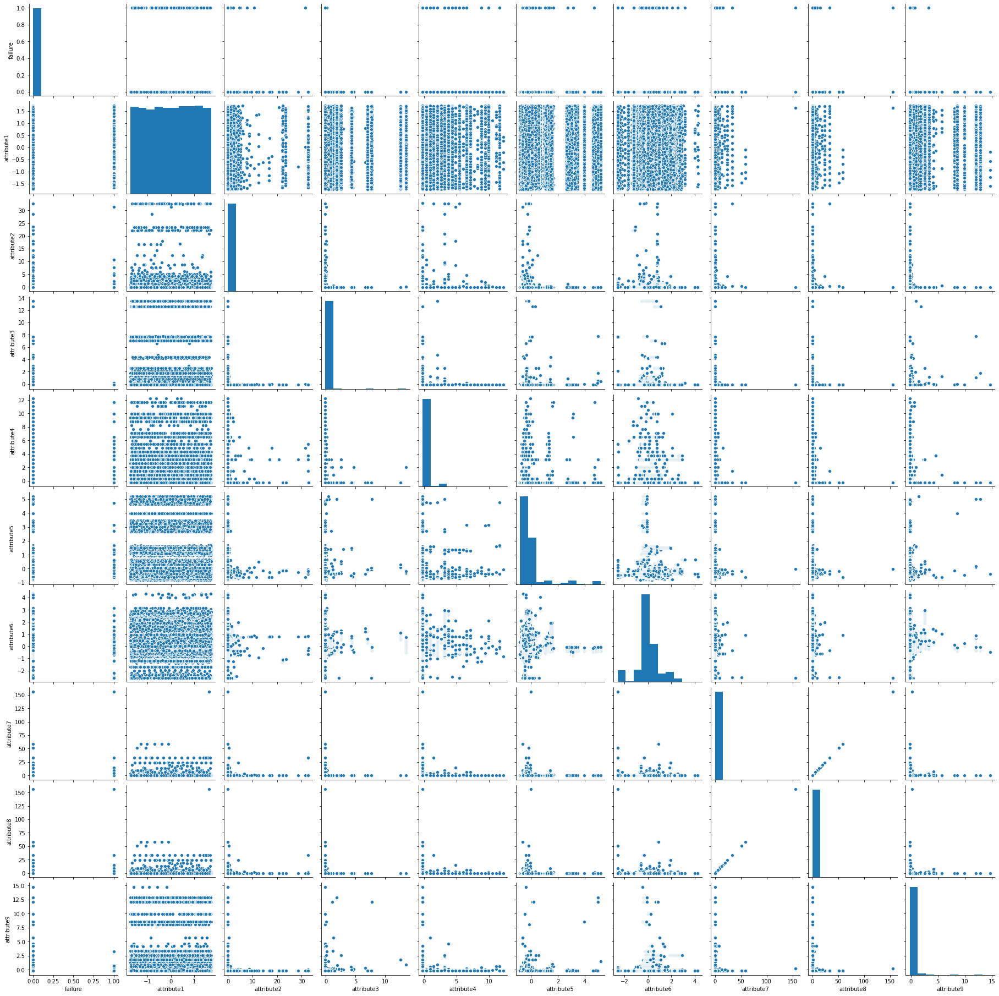

In [124]:
sns.pairplot(df2)

In [125]:
df2.shape

(121318, 12)

## 1-9. Plot the feature by recent time window

array([<matplotlib.axes._subplots.AxesSubplot object at 0x7f2198223b00>,
      dtype=object)

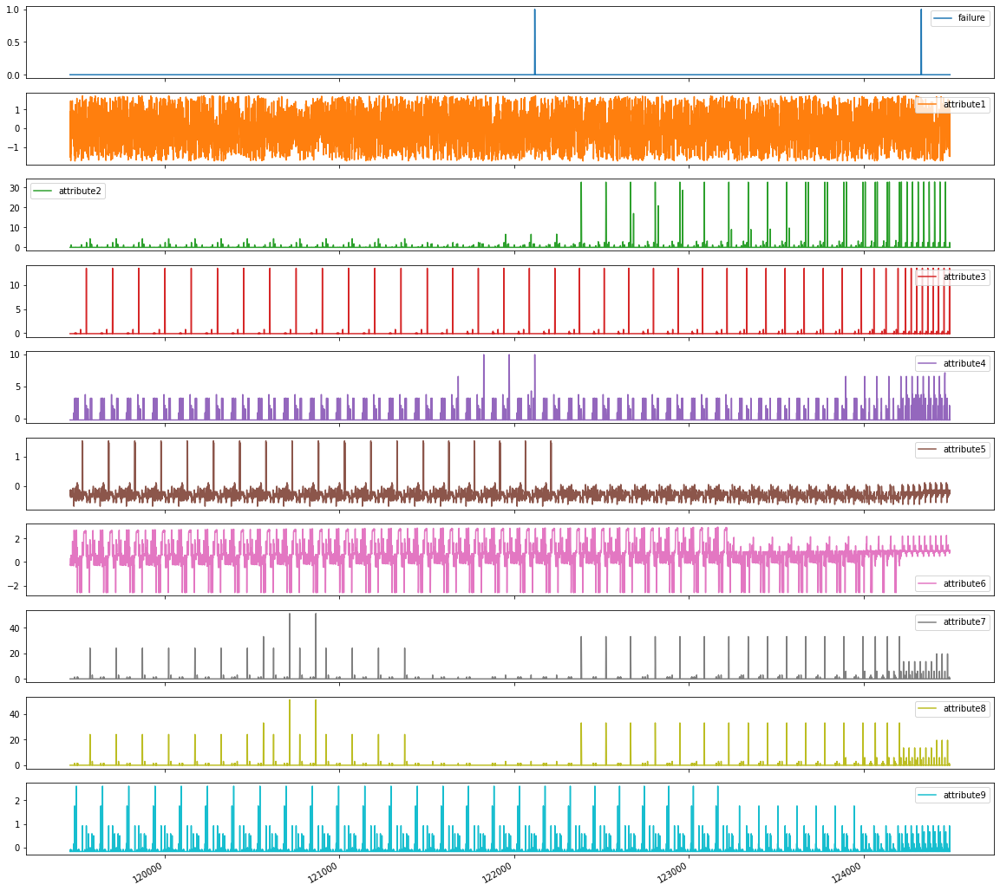

In [126]:
df2[-5000:].plot(subplots=True, figsize=(20,20))

### 1-10. Device => One hot enconding

"device" feature has 1118 unique values.

But, I'm not going to use this feature for the training to simplify the problem.

In [127]:
len(df2)

121318

In [0]:
df2 = df2.reset_index(drop=True)

In [0]:
from sklearn.preprocessing import OneHotEncoder, LabelBinarizer

lb = LabelBinarizer()
lb.fit(df2['device'])
transformed = lb.transform(df2['device'])
ohe_df = pd.DataFrame(transformed)
df3 = pd.concat([df2, ohe_df], axis=1).drop(['device'], axis=1)

In [130]:
ohe_df.head()

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37,38,39,...,1078,1079,1080,1081,1082,1083,1084,1085,1086,1087,1088,1089,1090,1091,1092,1093,1094,1095,1096,1097,1098,1099,1100,1101,1102,1103,1104,1105,1106,1107,1108,1109,1110,1111,1112,1113,1114,1115,1116,1117
0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [131]:
df2.head()

,date,device,failure,attribute1,attribute2,attribute3,attribute4,attribute5,attribute6,attribute7,attribute8,attribute9
0,2015-01-01,S1F0166B,0,-0.865604,-0.070709,0.262350,-0.219277,-0.513329,1.439477,-0.040481,-0.040481,-0.175571
1,2015-01-01,S1F01E6Y,0,0.722425,-0.070709,-0.119606,-0.219277,-0.140418,-0.220254,-0.040481,-0.040481,-0.175571
2,2015-01-01,S1F01JE0,0,-0.605627,-0.070709,-0.119606,-0.219277,-0.513329,1.509678,-0.040481,-0.040481,-0.175571
3,2015-01-01,S1F01R2B,0,0.192840,-0.070709,-0.119606,-0.219277,0.046037,0.538418,-0.040481,-0.040481,0.077527
4,2015-01-01,S1F01XDJ,0,1.494633,-0.070709,-0.119606,-0.219277,-0.389025,1.432979,-0.040481,-0.040481,-0.175571


In [132]:
df3.head()

,date,failure,attribute1,attribute2,attribute3,attribute4,attribute5,attribute6,attribute7,attribute8,attribute9,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28,...,1078,1079,1080,1081,1082,1083,1084,1085,1086,1087,1088,1089,1090,1091,1092,1093,1094,1095,1096,1097,1098,1099,1100,1101,1102,1103,1104,1105,1106,1107,1108,1109,1110,1111,1112,1113,1114,1115,1116,1117
0,2015-01-01,0,-0.865604,-0.070709,0.262350,-0.219277,-0.513329,1.439477,-0.040481,-0.040481,-0.175571,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,2015-01-01,0,0.722425,-0.070709,-0.119606,-0.219277,-0.140418,-0.220254,-0.040481,-0.040481,-0.175571,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,2015-01-01,0,-0.605627,-0.070709,-0.119606,-0.219277,-0.513329,1.509678,-0.040481,-0.040481,-0.175571,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,2015-01-01,0,0.192840,-0.070709,-0.119606,-0.219277,0.046037,0.538418,-0.040481,-0.040481,0.077527,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,2015-01-01,0,1.494633,-0.070709,-0.119606,-0.219277,-0.389025,1.432979,-0.040481,-0.040481,-0.175571,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


## 1-11. Preprocessing multi-variate time-series data

- We have 8 features ( attribute1,2,3,4,5,6,7,9 )
- Target: failure
- Time window: 20 (We can change the time window like hyperparam)

So, train_data shape would be like (?, 20, 8) and train_label shape would be like (?, )


![대체 텍스트](https://www.tensorflow.org/tutorials/structured_data/images/time_series.png)

In [133]:
len(df2)

121318

In [0]:
def multivariate_data(dataset, target, start_index, end_index, history_size,
                      target_size, step, single_step=False):
  data = []
  labels = []

  start_index = start_index + history_size
  if end_index is None:
    end_index = len(dataset) - target_size

  for i in range(start_index, end_index):
    indices = range(i-history_size, i, step)
    data.append(dataset[indices])

    if single_step:
      labels.append(target[i+target_size])
    else:
      labels.append(target[i:i+target_size])

  return np.array(data), np.array(labels)

In [0]:
feature_columns = ['attribute1', 'attribute2', 'attribute3', 'attribute4', 'attribute5',
     'attribute6', 'attribute7', 'attribute9']

In [0]:
total_time_data, total_time_label = multivariate_data(
    dataset=df2.loc[:,feature_columns].to_numpy(), 
    target=df2.loc[:,'failure'].to_numpy(), start_index=0, end_index=len(df2)-1, 
    history_size=20, target_size=0, step=1, single_step=True)

In [137]:
total_time_data.shape, total_time_label.shape

((121297, 20, 8), (121297,))

In [0]:
time_test_split = int(len(total_time_data)*0.2)

time_train_data = total_time_data[:-time_test_split]   # 8:2
time_train_label = total_time_label[:-time_test_split] # 8:2
time_test_data = total_time_data[-time_test_split:]   # 8:2
time_test_label = total_time_label[-time_test_split:] # 8:2

time_train_dataset = tf.data.Dataset.from_tensor_slices((time_train_data, time_train_label))
time_test_dataset = tf.data.Dataset.from_tensor_slices((time_test_data, time_test_label))


In [0]:
total_data = df2.loc[:,feature_columns].to_numpy()
total_label = df2.loc[:,'failure'].to_numpy()
np.save("total_data.npy", total_data)
np.save("total_label.npy", total_label)
test_split = int(len(total_data)*0.2)

train_data = total_data[:-test_split]   # 8:2
train_label = total_label[:-test_split] # 8:2
test_data = total_data[-test_split:]   # 8:2
test_label = total_label[-test_split:] # 8:2

train_dataset = tf.data.Dataset.from_tensor_slices((train_data, train_label))
test_dataset = tf.data.Dataset.from_tensor_slices((test_data, test_label))

In [0]:
ohe_feature_columns = [i for i in range(1118)]
ohe_total_data = df3.loc[:,feature_columns+ohe_feature_columns].to_numpy()
ohe_total_label = df3.loc[:,'failure'].to_numpy()

In [141]:
ohe_total_data.shape

(121318, 1126)

In [0]:
ohe_test_split = int(len(ohe_total_data)*0.2)

ohe_train_data = ohe_total_data[:-ohe_test_split]   # 8:2
ohe_train_label = ohe_total_label[:-ohe_test_split] # 8:2
ohe_test_data = ohe_total_data[-ohe_test_split:]   # 8:2
ohe_test_label = ohe_total_label[-ohe_test_split:] # 8:2

ohe_train_dataset = tf.data.Dataset.from_tensor_slices((ohe_train_data, ohe_train_label))
ohe_test_dataset = tf.data.Dataset.from_tensor_slices((ohe_test_data, ohe_test_label))

## 2. Tensorflow 2.0 Training Code

I designed 3 models as draft.

**1) 8 Feature binary classification**

2) 20 X 8 Time-series binary classification

3) 8 Features + 1118 OHE features binary classification

Since the first approach is more promising, I'm going to upgrade this model.

In [0]:
BATCH_SIZE = 64
SHUFFLE_BUFFER_SIZE = 100

In [0]:
import tensorflow as tf

model = tf.keras.Sequential(
    [
     tf.keras.layers.Dense(256, input_shape=(8,)),
     tf.keras.layers.Dense(64, activation='relu', 
                           kernel_regularizer=tf.keras.regularizers.l2(0.01)),
     tf.keras.layers.Dropout(0.5),
     tf.keras.layers.Dense(1, activation='sigmoid')
    ])

model.compile(optimizer='adam', loss='binary_crossentropy')

In [145]:
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', 
                                                  patience=10)
model.fit(train_dataset.shuffle(SHUFFLE_BUFFER_SIZE).batch(BATCH_SIZE), 
          validation_data=test_dataset.batch(BATCH_SIZE), 
          epochs=100, verbose=1, callbacks=[early_stopping])

Epoch 1/100
1517/1517 [==============================] - 5s 3ms/step - loss: 0.0730 - val_loss: 0.0084
Epoch 2/100
1517/1517 [==============================] - 4s 3ms/step - loss: 0.0079 - val_loss: 0.0067
Epoch 3/100
1517/1517 [==============================] - 4s 3ms/step - loss: 0.0069 - val_loss: 0.0064
Epoch 4/100
1517/1517 [==============================] - 4s 3ms/step - loss: 0.0076 - val_loss: 0.0064
Epoch 5/100
1517/1517 [==============================] - 4s 3ms/step - loss: 0.0066 - val_loss: 0.0061
Epoch 6/100
1517/1517 [==============================] - 4s 3ms/step - loss: 0.0072 - val_loss: 0.0064
Epoch 7/100
1517/1517 [==============================] - 4s 3ms/step - loss: 0.0064 - val_loss: 0.0061
Epoch 8/100
1517/1517 [==============================] - 4s 3ms/step - loss: 0.0072 - val_loss: 0.0066
Epoch 9/100
1517/1517 [==============================] - 4s 3ms/step - loss: 0.0064 - val_loss: 0.0063
Epoch 10/100
1517/1517 [==============================] - 4s 3ms/step - l

In [0]:
import tensorflow as tf

model2 = tf.keras.Sequential(
    [
     tf.keras.layers.Dense(256, input_shape=(20, 8,)),
     tf.keras.layers.Dense(64, activation='relu', 
                           kernel_regularizer=tf.keras.regularizers.l2(0.01)),
     tf.keras.layers.Dropout(0.5),
     tf.keras.layers.Dense(1, activation='sigmoid')
    ])

model2.compile(optimizer='adam', loss='binary_crossentropy')


In [147]:
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', 
                                                  patience=3)
model2.fit(time_train_dataset.shuffle(SHUFFLE_BUFFER_SIZE).batch(BATCH_SIZE), 
          validation_data=time_test_dataset.batch(BATCH_SIZE), 
          epochs=100, verbose=1, callbacks=[early_stopping])

Epoch 1/100
1517/1517 [==============================] - 8s 5ms/step - loss: 0.0805 - val_loss: 0.0084
Epoch 2/100
1517/1517 [==============================] - 8s 5ms/step - loss: 0.0073 - val_loss: 0.0076
Epoch 3/100
1517/1517 [==============================] - 8s 5ms/step - loss: 0.0066 - val_loss: 0.0072
Epoch 4/100
1517/1517 [==============================] - 8s 5ms/step - loss: 0.0063 - val_loss: 0.0070
Epoch 5/100
1517/1517 [==============================] - 8s 5ms/step - loss: 0.0062 - val_loss: 0.0069
Epoch 6/100
1517/1517 [==============================] - 7s 5ms/step - loss: 0.0060 - val_loss: 0.0068
Epoch 7/100
1517/1517 [==============================] - 8s 5ms/step - loss: 0.0060 - val_loss: 0.0068
Epoch 8/100
1517/1517 [==============================] - 8s 5ms/step - loss: 0.0061 - val_loss: 0.0067
Epoch 9/100
1517/1517 [==============================] - 8s 5ms/step - loss: 0.0059 - val_loss: 0.0067
Epoch 10/100
1517/1517 [==============================] - 8s 6ms/step - l

In [0]:
import tensorflow as tf

ohe_model = tf.keras.Sequential(
    [
     tf.keras.layers.Dense(256, input_shape=(1126,), 
                           kernel_regularizer=tf.keras.regularizers.l1(0.01)),
     tf.keras.layers.Dense(64, activation='relu', 
                           kernel_regularizer=tf.keras.regularizers.l2(0.01)),
     tf.keras.layers.Dropout(0.5),
     tf.keras.layers.Dense(1, activation='sigmoid')
    ])

ohe_model.compile(optimizer='adam', loss='binary_crossentropy')

In [149]:
early_stopping = tf.keras.callbacks.EarlyStopping(monitor='val_loss', 
                                                  patience=3)
ohe_model.fit(ohe_train_dataset.shuffle(SHUFFLE_BUFFER_SIZE).batch(BATCH_SIZE), 
          validation_data=ohe_test_dataset.batch(BATCH_SIZE), 
          epochs=100, verbose=1, callbacks=[early_stopping])

Epoch 1/100
1517/1517 [==============================] - 6s 4ms/step - loss: 1.8650 - val_loss: 0.3337
Epoch 2/100
1517/1517 [==============================] - 6s 4ms/step - loss: 0.3308 - val_loss: 0.3308
Epoch 3/100
1517/1517 [==============================] - 6s 4ms/step - loss: 0.3296 - val_loss: 0.3294
Epoch 4/100
1517/1517 [==============================] - 6s 4ms/step - loss: 0.3288 - val_loss: 0.3287
Epoch 5/100
1517/1517 [==============================] - 6s 4ms/step - loss: 0.3287 - val_loss: 0.3299
Epoch 6/100
1517/1517 [==============================] - 6s 4ms/step - loss: 0.3284 - val_loss: 0.3297
Epoch 7/100
1517/1517 [==============================] - 6s 4ms/step - loss: 0.3281 - val_loss: 0.3286
Epoch 8/100
1517/1517 [==============================] - 6s 4ms/step - loss: 0.3282 - val_loss: 0.3300
Epoch 9/100
1517/1517 [==============================] - 7s 4ms/step - loss: 0.3283 - val_loss: 0.3283
Epoch 10/100
1517/1517 [==============================] - 6s 4ms/step - l